In [14]:
# Import libaries
from ultralytics import YOLO
import os
import random
import cv2
import numpy as np
import shutil
import supervision as sv
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import time
import pandas as pd
from IPython.display import display

In [15]:
# Define keypoints on minipitch (pitch.png)
keypoints = {1: (44, 30), 2: (457, 30), 3: (44, 563), 4: (457, 563), 5: (44, 138), 6: (174, 138), 7: (174, 230), 8: (174, 346), 9: (174, 453), 10: (44, 453), 11: (44, 230), 12: (86, 230), 13: (86, 368), 14: (44, 368), 15: (130, 295), 16: (457, 230), 17: (457, 295), 18: (457, 368), 19: (201, 295), 20: (387, 295), 21: (530, 295), 22: (870, 30), 23: (870, 563), 24: (870, 138), 25: (740, 138), 26: (740, 230), 27: (740, 346), 28: (740, 453), 29: (870, 453), 30: (870, 230), 31: (827, 230), 32: (827, 368), 33: (870, 368), 34: (785, 295), 35: (712, 295)}

In [16]:
# Choose dataset 1 or 2:
dataset = 2  # 1 or 2

if dataset == 1:
    data_folder = "1_train-val_1min_aalesund_from_start"
    yaml_file = "yaml_files/keypoint_1.yaml"
    labels = "labels_1"

else:
    data_folder = "2_train-val_1min_after_goal"
    yaml_file = "yaml_files/keypoint_2.yaml"
    labels = "labels_2"

In [17]:
# Find the latest model with the best performance
def find_latest_model_with_best(base_path, data_folder, type='keypoints'):
    detect_path = os.path.join(base_path, 'runs', type, data_folder)
    training_sessions = [os.path.join(detect_path, d) for d in os.listdir(detect_path) if os.path.isdir(os.path.join(detect_path, d))]
    
    best_model_paths = []

    for session in training_sessions:
        best_model_path = os.path.join(session, 'weights', 'best.pt')
        if os.path.exists(best_model_path):
            best_model_paths.append((best_model_path, os.path.getmtime(best_model_path)))

    if not best_model_paths:
        print("Ingen 'best.pt' fil funnet i noen av treningsøktene.")
        return None
    
    best_model_paths.sort(key=lambda x: x[1], reverse=True)
    print(f"Bruker modell fra {best_model_paths[0][0]}")
    return best_model_paths[0][0]


base_path = '/work/mbergst/TDT4265_Project' 

In [18]:
# Initialize a trained keypoint detection model for mapping
model = YOLO(find_latest_model_with_best(base_path, data_folder))

Bruker modell fra /work/mbergst/TDT4265_Project/runs/keypoints/2_train-val_1min_after_goal/train/weights/best.pt


In [19]:
# Define paths to all frames in datafolder
all_frames = f'/datasets/tdt4265/other/rbk/{data_folder}/img1'
frame_paths = sorted([os.path.join(all_frames, f) for f in os.listdir(all_frames) if f.endswith('.jpg')])


In [20]:
%matplotlib inline

def within_image_bounds(image, x, y):
    return 0 <= x < image.width and 0 <= y < image.height


# Function for plotting detections on image
def plot_pred_on_image(ax, image_path, keypoints, keypoint_labels, players, ball, point_radius=5, label_offset=(10, -10)):

    image = Image.open(image_path)
    ax.imshow(image)

    # Check if the plot is outside image dimensions

    for (x, y), label in zip(keypoints, keypoint_labels):
        if within_image_bounds(image, x, y):
            ax.scatter(x, y, color='blue', s=point_radius**2)
            ax.text(x + label_offset[0], y + label_offset[1], label, color='blue', fontsize=9)
        else:
            print(f"Point {label} is outside image dimensions: {x}, {y}")
    
    if dataset == 1:
        players = [(image.width - x, y) for x, y in players]
        ball = (image.width - ball[0], ball[1])

    for player in players:
        if within_image_bounds(image, player[0], player[1]):
            ax.scatter(player[0], player[1], color='purple', s=point_radius**2)
        else:
            print(f"Player is outside image dimensions: {player[0]}, {player[1]}")

    if within_image_bounds(image, ball[0], ball[1]):
        ax.scatter(ball[0], ball[1], color='orange', s=point_radius**2)
    else:
        print(f"Ball is outside image dimensions: {ball[0]}, {ball[1]}")
    
    ax.axis('off')


Known coordinates of each keypoint on pitch:


,1,2,3,4,5,6,7,8,9,10,...,26,27,28,29,30,31,32,33,34,35
x,44,457,44,457,44,174,174,174,174,44,...,740,740,740,870,870,827,827,870,785,712
y,30,30,563,563,138,138,230,346,453,453,...,230,346,453,453,230,230,368,368,295,295



image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000001.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2.3ms
Speed: 2.7ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000001.jpg: 1088x1920 23 players, 2.5ms
Speed: 2.4ms preprocess, 2.5ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000001.jpg: 1088x1920 1 ball, 2.4ms
Speed: 3.0ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)


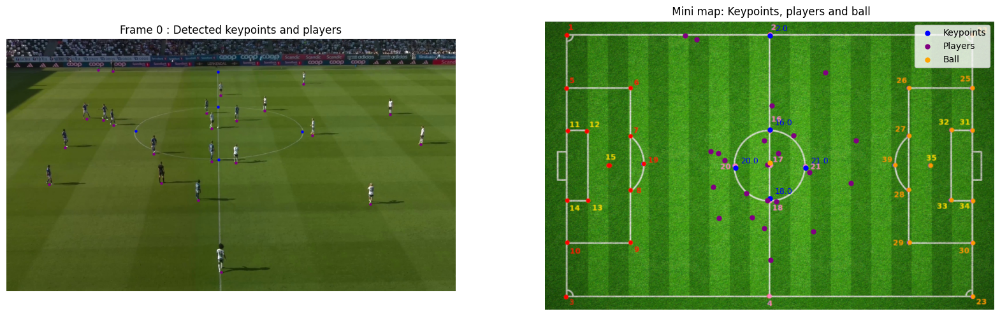


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000101.jpg: 736x1280 1 kp2, 1 kp18, 1 kp20, 1 kp21, 2.4ms
Speed: 2.5ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000101.jpg: 1088x1920 23 players, 2.4ms
Speed: 2.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000101.jpg: 1088x1920 1 ball, 2.4ms
Speed: 2.3ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)


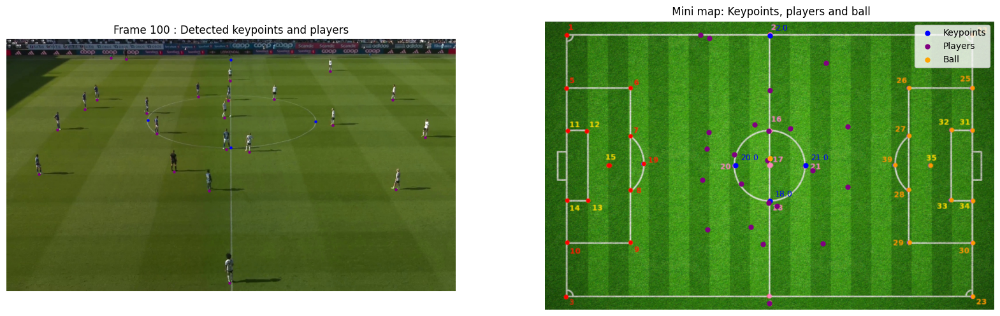


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000201.jpg: 736x1280 1 kp2, 1 kp16, 1 kp20, 1 kp21, 2.6ms
Speed: 2.4ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000201.jpg: 1088x1920 23 players, 2.5ms
Speed: 2.7ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000201.jpg: 1088x1920 1 ball, 2.3ms
Speed: 2.9ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)


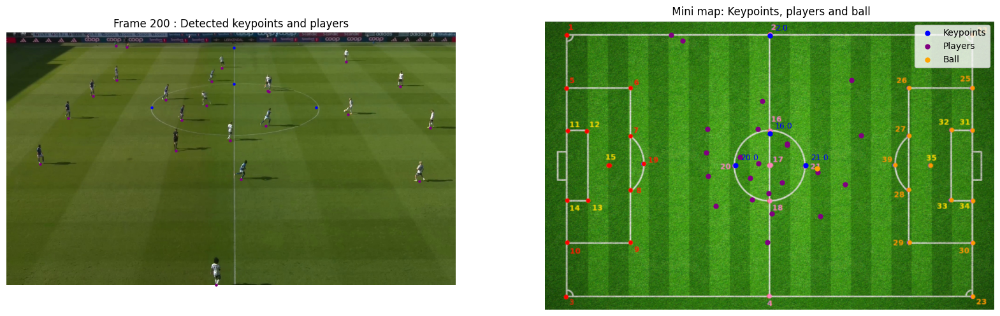


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000301.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 1 kp26, 2.4ms
Speed: 2.6ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000301.jpg: 1088x1920 23 players, 2.3ms
Speed: 2.9ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000301.jpg: 1088x1920 1 ball, 2.3ms
Speed: 2.9ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 270.39035842911034, -58.512374643809565
Player is outside image dimensions: 188.54696641814078, -99.05562333670669


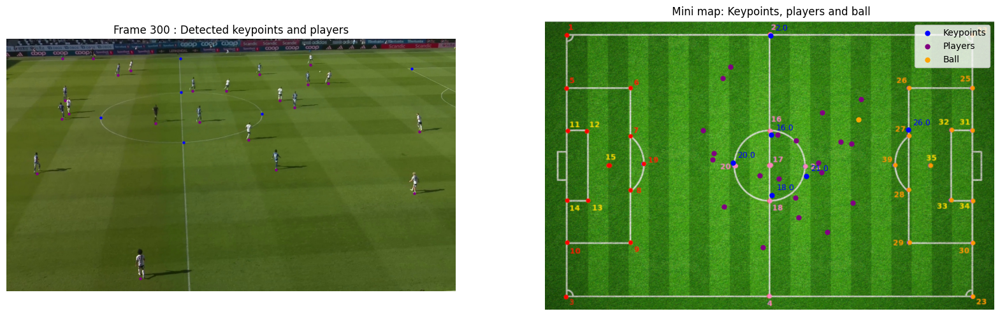


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000401.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 1 kp26, 2.4ms
Speed: 2.3ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000401.jpg: 1088x1920 23 players, 2.4ms
Speed: 3.0ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000401.jpg: 1088x1920 1 ball, 2.4ms
Speed: 2.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 268.2450698956161, -47.97388063133805
Player is outside image dimensions: 223.22777921400524, -74.05325066610145


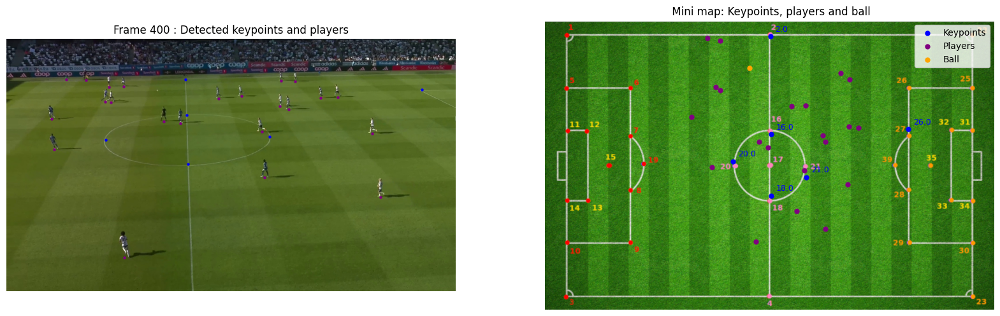


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000501.jpg: 736x1280 1 kp2, 1 kp6, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2.5ms
Speed: 2.4ms preprocess, 2.5ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000501.jpg: 1088x1920 23 players, 2.3ms
Speed: 3.2ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000501.jpg: 1088x1920 1 ball, 2.4ms
Speed: 3.2ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)


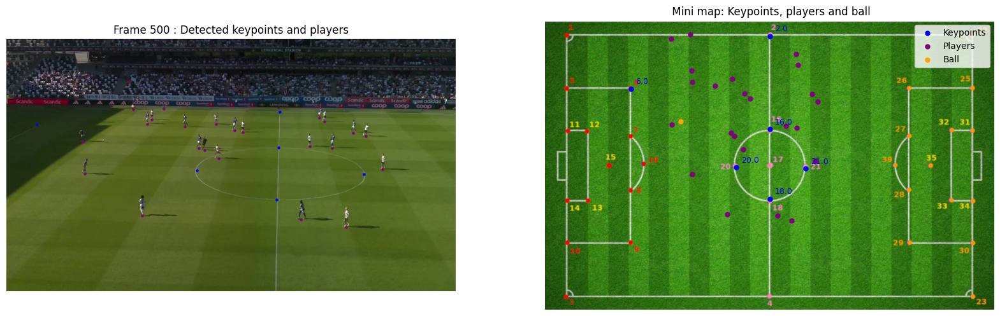


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000601.jpg: 736x1280 1 kp2, 1 kp6, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2.5ms
Speed: 2.8ms preprocess, 2.5ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000601.jpg: 1088x1920 23 players, 2.3ms
Speed: 3.0ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000601.jpg: 1088x1920 1 ball, 2.4ms
Speed: 3.2ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Ball is outside image dimensions: 467.94099657966774, -168.88466379752856


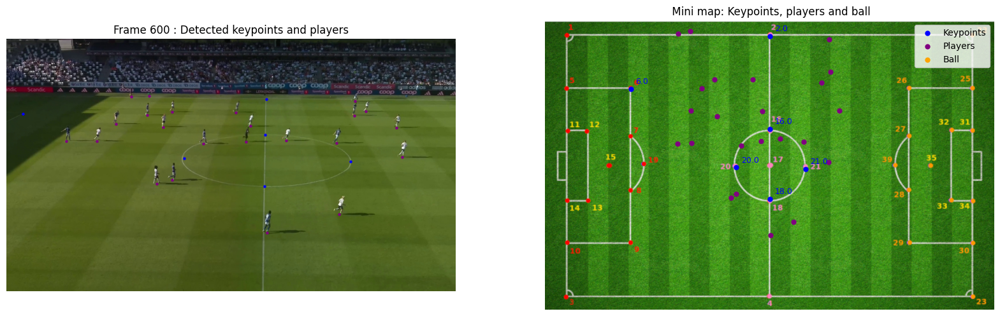


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000701.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 1 kp26, 2.5ms
Speed: 2.4ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000701.jpg: 1088x1920 23 players, 2.4ms
Speed: 3.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000701.jpg: 1088x1920 1 ball, 2.4ms
Speed: 2.9ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 327.15381800200174, -18.869275288530137
Player is outside image dimensions: 225.62253944164104, -68.12006822678765


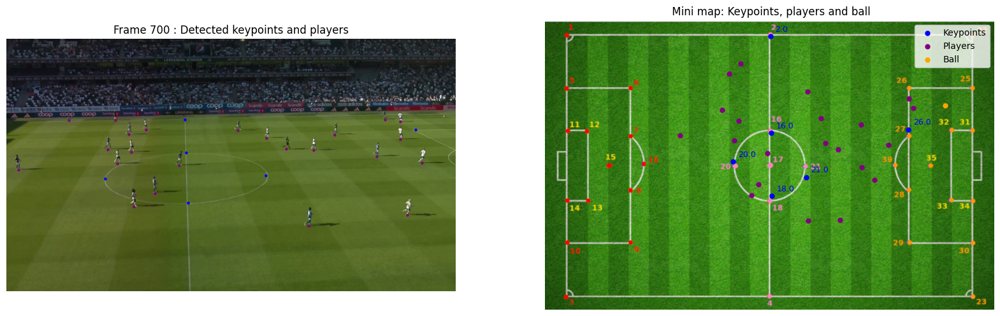


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000801.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2 kp26s, 2.4ms
Speed: 2.4ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000801.jpg: 1088x1920 22 players, 2.3ms
Speed: 2.9ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000801.jpg: 1088x1920 1 ball, 2.4ms
Speed: 3.0ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 354.08721197326474, -19.70820557119956


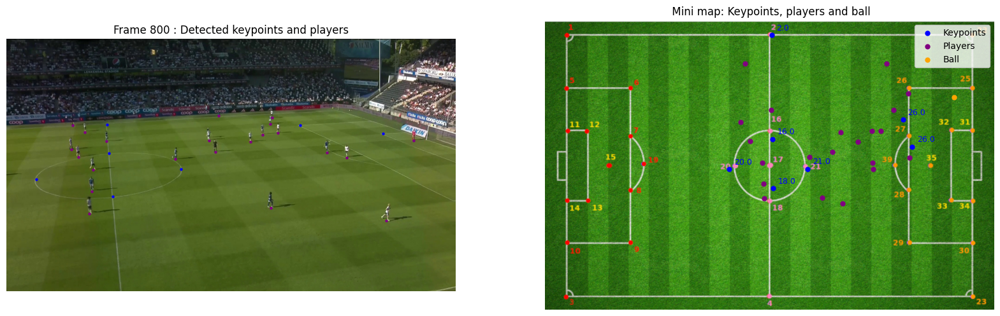


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000901.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2 kp26s, 2.4ms
Speed: 2.5ms preprocess, 2.4ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000901.jpg: 1088x1920 24 players, 2.4ms
Speed: 2.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/000901.jpg: 1088x1920 1 ball, 2.4ms
Speed: 2.7ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 363.4672252221709, -15.40429160665969


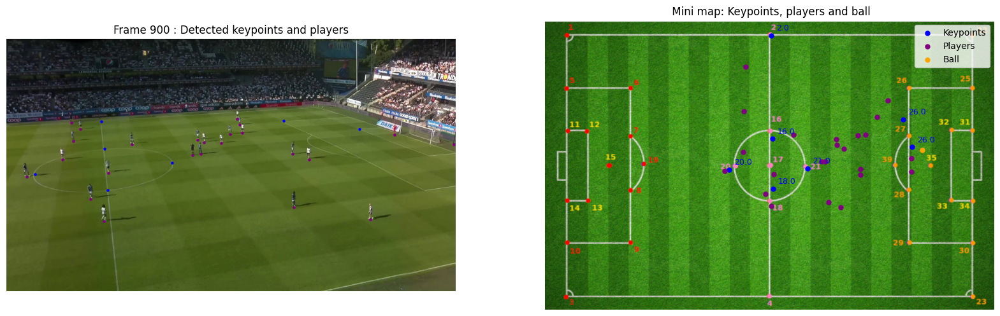


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001001.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2 kp26s, 2.5ms
Speed: 2.3ms preprocess, 2.5ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001001.jpg: 1088x1920 22 players, 2.4ms
Speed: 3.2ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001001.jpg: 1088x1920 1 ball, 2.4ms
Speed: 3.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 359.0352042272351, -8.275221781384351
Ball is outside image dimensions: 463.92371884329935, -157.8312008269604


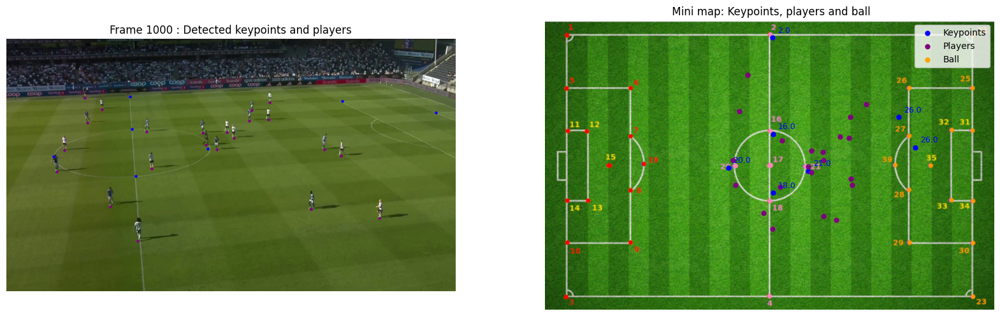


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001101.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 1 kp26, 2.5ms
Speed: 2.5ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001101.jpg: 1088x1920 23 players, 2.4ms
Speed: 3.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001101.jpg: 1088x1920 (no detections), 2.4ms
Speed: 3.0ms preprocess, 2.4ms inference, 0.2ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 344.0313221633075, -16.246552854025218
Player is outside image dimensions: 220.3917927584377, -76.49074894278519
Ball is outside image dimensions: 463.92371884329935, -157.8312008269604


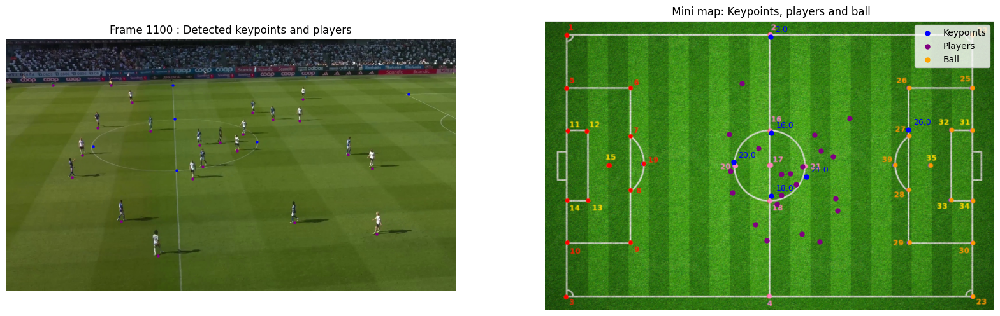


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001201.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 1 kp26, 3.2ms
Speed: 3.1ms preprocess, 3.2ms inference, 0.7ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001201.jpg: 1088x1920 23 players, 2.8ms
Speed: 3.2ms preprocess, 2.8ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001201.jpg: 1088x1920 (no detections), 2.5ms
Speed: 2.6ms preprocess, 2.5ms inference, 0.3ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: 313.1639754336993, -32.294714893130326
Player is outside image dimensions: 220.95252927089277, -76.8704199402906
Ball is outside image dimensions: 463.92371884329935, -157.8312008269604


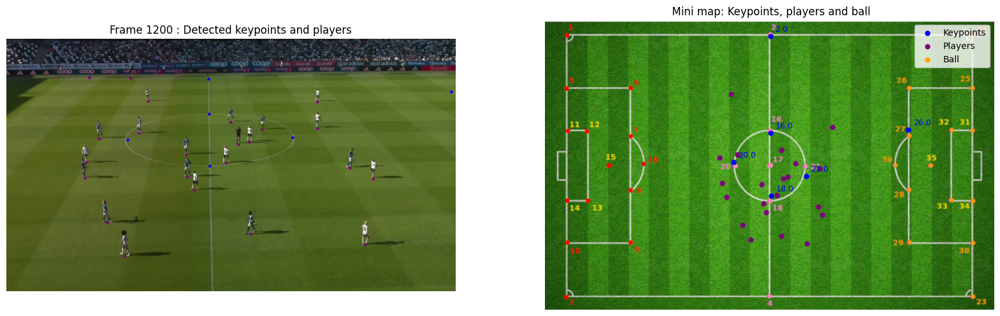


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001301.jpg: 736x1280 1 kp2, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2.5ms
Speed: 2.6ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001301.jpg: 1088x1920 22 players, 2.4ms
Speed: 3.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001301.jpg: 1088x1920 1 ball, 2.3ms
Speed: 2.9ms preprocess, 2.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)
Ball is outside image dimensions: 387.57800225914986, -113.25731181399695


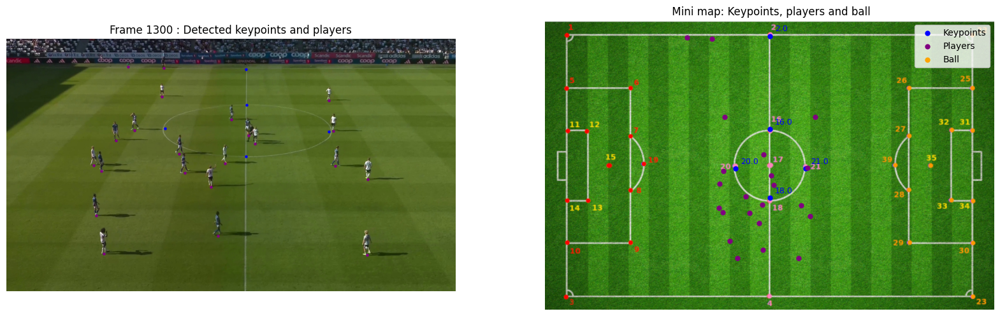


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001401.jpg: 736x1280 1 kp2, 1 kp6, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2.5ms
Speed: 2.8ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001401.jpg: 1088x1920 23 players, 2.4ms
Speed: 3.1ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001401.jpg: 1088x1920 (no detections), 2.4ms
Speed: 3.1ms preprocess, 2.4ms inference, 0.2ms postprocess per image at shape (1, 3, 1088, 1920)
Ball is outside image dimensions: 387.57800225914986, -113.25731181399695


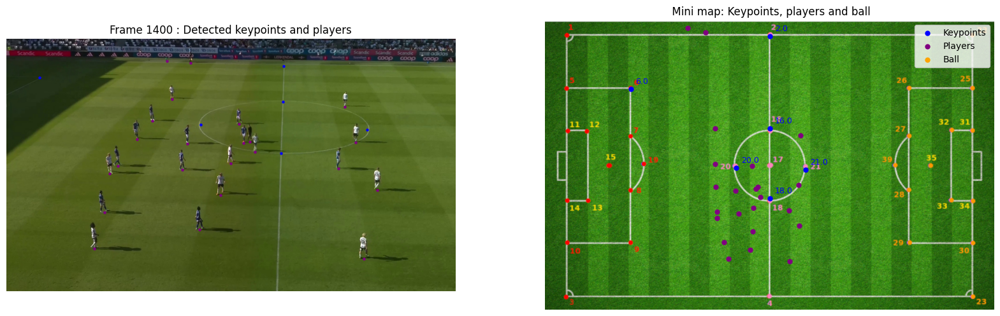


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001501.jpg: 736x1280 1 kp2, 1 kp6, 1 kp7, 1 kp16, 1 kp18, 1 kp20, 1 kp21, 2.5ms
Speed: 2.4ms preprocess, 2.5ms inference, 0.5ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001501.jpg: 1088x1920 23 players, 2.4ms
Speed: 3.2ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001501.jpg: 1088x1920 1 ball, 2.4ms
Speed: 2.9ms preprocess, 2.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)


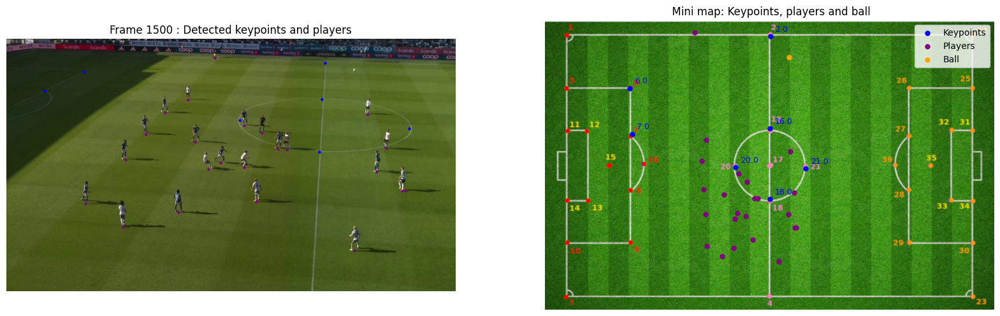


image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001601.jpg: 736x1280 1 kp2, 1 kp6, 1 kp7, 1 kp16, 1 kp18, 1 kp19, 1 kp20, 1 kp21, 2.5ms
Speed: 2.5ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001601.jpg: 1088x1920 20 players, 2.5ms
Speed: 3.2ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/2_train-val_1min_after_goal/img1/001601.jpg: 1088x1920 1 ball, 2.5ms
Speed: 2.5ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


KeyboardInterrupt: 

In [21]:
# Keypoint mapping

# Load player and ball detection models to use for mapping
model_players = YOLO('/work/mbergst/TDT4265_Project/runs/detect/player/train7/weights/best.pt')
model_ball = YOLO('/work/mbergst/TDT4265_Project/runs/detect/ball/train12/weights/best.pt')

print("Known coordinates of each keypoint on pitch:")
display(pd.DataFrame(keypoints, index = ['x', 'y']))

# Initialize frame numbers
frame_number = 0

mini_map_path = 'pitch.png'

# Iterate over frames
for i, frame in enumerate(frame_paths):
    frame_number = i 
    if frame_number % 100 == 0:
        for result_keyp, result_player, result_ball in zip(model.track(frame), model_players.track(frame), model_ball.track(frame)):
            
            # bounding boxes and labels for keypoints, players and ball
            bboxes_keyp = result_keyp.boxes.xyxy.cpu().numpy()
            bboxes_keyp_c = result_keyp.boxes.xywh.cpu().numpy()
            labels_keyp = list(result_keyp.boxes.cls.cpu().numpy())


            bboxes_player = result_player.boxes.xyxy.cpu().numpy()
            bboxes_player_c = result_player.boxes.xywh.cpu().numpy()
            labels_player = list(result_player.boxes.cls.cpu().numpy())
            

            bboxes_ball = result_ball.boxes.xyxy.cpu().numpy()
            bboxes_ball_c = result_ball.boxes.xywh.cpu().numpy()
            labels_ball = list(result_ball.boxes.cls.cpu().numpy())

            # Detected labels source points
            detected_labels_src = np.array([list(np.round(bboxes_keyp_c[i][:2]).astype(int)) for i in range(bboxes_keyp_c.shape[0])])
            image = Image.open(frame)

            # Detected labels destination points
            detected_labels_dst = np.array([keypoints[i +1] for i in labels_keyp])

            bboxes_player_c_0 = bboxes_player_c[[i==0 for i in labels_player]]

            # Get coordinates of detected players as x_center, y_center + h/2
            detected_player_src = bboxes_player_c[:, :2] + np.array([[0]*bboxes_player_c_0.shape[0], bboxes_player_c_0[:, 3] / 2]).T

            # Get coordinates of detected ball as x_center, y_center
            detected_ball_src = bboxes_ball_c[0, :2] if len(bboxes_ball_c) > 0 else []

            # Calculate homography transformation matrix if more than 3 keypoints are detected
            if len(detected_labels_src) > 3:
                H, _ = cv2.findHomography(detected_labels_src, detected_labels_dst)

                pred_dest_keypoints = []
                for pt in detected_labels_src:
                    pt = np.append(np.array(pt), np.array([1]), axis=0) 
                    dest_point = np.matmul(H, np.transpose(pt))
                    dest_point = dest_point / dest_point[2]
                    pred_dest_keypoints.append(list(np.transpose(dest_point)[:2]))
                pred_dest_keypoints = np.array(pred_dest_keypoints)

                pred_player_points = []
                for pt in detected_player_src:
                    pt = np.append(np.array(pt), np.array([1]), axis=0) 
                    dest_point = np.matmul(H, np.transpose(pt))
                    dest_point = dest_point / dest_point[2]
                    pred_player_points.append(list(np.transpose(dest_point)[:2]))
                pred_player_points = np.array(pred_player_points)

                if len(detected_ball_src) > 0:
                    pt = np.append(np.array(detected_ball_src), np.array([1]), axis=0) 
                    dest_point = np.matmul(H, np.transpose(pt))
                    dest_point = dest_point / dest_point[2]
                    detected_ball_dst = np.transpose(dest_point)

                # Add +1 for every label to match the pitch picture when plotting
                labels_keyp = [label + 1 for label in labels_keyp]

                plt.ion()
                fig, axes = plt.subplots(1, 2, figsize=(20, 16))

                axes[0].imshow(image)
                for keypoint in detected_labels_src:
                    axes[0].scatter(keypoint[0], keypoint[1], color='blue', s=5)
                for player in detected_player_src:
                    axes[0].scatter(player[0], player[1], color='purple', s=5)
                
                # Dont plot ball since the dot covers it on the frame, can see it on the minimap
                # if len(detected_ball_src) > 0:
                #     axes[0].scatter(detected_ball_src[0], detected_ball_src[1], color='orange', s=5)
                
                axes[0].axis('off')
                axes[0].title.set_text(f"Frame {frame_number} : Detected keypoints and players")

                # Draw keypoints, players and ball on pitch
                plot_pred_on_image(axes[1], mini_map_path, pred_dest_keypoints, labels_keyp, pred_player_points, detected_ball_dst)
                plt.legend(['Keypoints', 'Players', 'Ball'])
                leg = axes[1].get_legend()
                leg.legend_handles[0].set_color('blue')
                leg.legend_handles[1].set_color('purple')
                leg.legend_handles[2].set_color('orange')
                
                axes[1].title.set_text(" Mini map: Keypoints, players and ball")
                
                plt.show()
                
            else:
                print("Not enough keypoints detected for homography calculation in frame", frame_number)
                continue


        

